<a href="https://colab.research.google.com/github/SahinCatkin/Bootcamp/blob/main/2_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -q kaggle

In [2]:
from google.colab import files

In [3]:
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"ahinatkn","key":"82c41ed5f9466bed0a326f5e5be6ce2c"}'}

In [4]:
!mkdir ~/.kaggle

In [5]:
!cp kaggle.json ~/.kaggle/

In [7]:
!chmod 600 ~/.kaggle/kaggle.json

In [6]:
!kaggle datasets download -d kmader/synthetic-word-ocr

100% 3.92G/3.93G [02:12<00:00, 42.9MB/s]
100% 3.93G/3.93G [02:12<00:00, 31.8MB/s]


In [8]:
!unzip /content/synthetic-word-ocr.zip -d train

Streaming output truncated to the last 5000 lines.
  inflating: train/train/images/000000275742.jpg  
  inflating: train/train/images/000000275743.jpg  
  inflating: train/train/images/000000275744.jpg  
  inflating: train/train/images/000000275745.jpg  
  inflating: train/train/images/000000275746.jpg  
  inflating: train/train/images/000000275747.jpg  
  inflating: train/train/images/000000275748.jpg  
  inflating: train/train/images/000000275749.jpg  
  inflating: train/train/images/000000275750.jpg  
  inflating: train/train/images/000000275751.jpg  
  inflating: train/train/images/000000275752.jpg  
  inflating: train/train/images/000000275753.jpg  
  inflating: train/train/images/000000275754.jpg  
  inflating: train/train/images/000000275755.jpg  
  inflating: train/train/images/000000275756.jpg  
  inflating: train/train/images/000000275757.jpg  
  inflating: train/train/images/000000275758.jpg  
  inflating: train/train/images/000000275759.jpg  
  inflating: train/train/images

In [31]:
def single_img_gen(c_df):
    """
    function to get a single image from a part of a dataframe
    """
    img_data = imread(os.path.join(map_img_dir, c_df['file_name'].values[0]))
    out_seg = np.expand_dims(rows_to_segmentation(img_data, c_df), -1)
    return (img_data/255.0).astype(np.float32), out_seg.astype(np.float32) 

# **NOTEBOOK-2**

In [152]:
# !pip install -q -U pip
!pip install -q cython
# Install pycocotools, the version by default in Colab
# has a bug fixed in https://github.com/cocodataset/cocoapi/pull/354
!pip install -q -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
!pip install -q -U segmentation-models-pytorch
# !pip install -q -U albumentations

  Preparing metadata (setup.py) ... done


In [214]:
import json
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.path as plt_path

from PIL import Image

from pathlib import Path
from pycocotools.coco import COCO

DATASET_PATH = Path('/content/train')
img_root_path = DATASET_PATH / 'train/images'

In [155]:
pip install -U albumentations

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 123.5/123.5 kB 8.0 MB/s eta 0:00:00


In [210]:
import albumentations as albu
from albumentations import (
    Compose, OneOf, Normalize, Resize, RandomResizedCrop, RandomCrop, HorizontalFlip, VerticalFlip, 
    RandomBrightness, RandomContrast, RandomBrightnessContrast, Rotate, ShiftScaleRotate, Cutout, 
    IAAAdditiveGaussianNoise, Transpose, Lambda
    )
from albumentations.pytorch import ToTensorV2

In [211]:
from sklearn.model_selection import train_test_split

In [212]:
import segmentation_models_pytorch as smp

In [213]:
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F

from torch.optim import Adam, SGD
from torch.nn.parameter import Parameter
from torch.utils.data import DataLoader, Dataset

from torchvision.io import read_image
import torchvision.models as models

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [160]:
print(torch.__version__)
print(torchvision.__version__)
print(albu.__version__)

2.0.1+cu118
0.15.2+cu118
1.2.1


In [161]:
anno_path = DATASET_PATH / 'annotation-small.json'
with open(DATASET_PATH / 'annotation-small.json', 'r') as f:
    annot_data = json.load(f)

In [162]:
coco_anno = COCO(str(anno_path))
cat_ids = coco_anno.getCatIds()
cats = coco_anno.loadCats(cat_ids)
img_ids = coco_anno.getImgIds(catIds=cat_ids)

loading annotations into memory...
Done (t=0.59s)
creating index...
index created!


In [163]:
EPOCHS = 10
BATCH_SIZE = 32

In [164]:
def seed_torch(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True


# https://stackoverflow.com/questions/50805634/how-to-create-mask-images-from-coco-dataset
def get_mask(coco, img_id, cat_ids):
    img_inf = coco.loadImgs(img_id)[0]
    img_shape = (img_inf['width'], img_inf['height'], len(cat_ids))
    ann_ids = coco_anno.getAnnIds(imgIds=img_id,
                                  catIds=cat_ids,
                                  iscrowd=None)
    anns = coco.loadAnns(ann_ids)
#     masks = np.zeros((img_inf['height'],img_inf['width'], len(cat_ids)))
#     for idx, cat_id in enumerate(cat_ids):
#         mask = np.zeros((img_inf['height'],img_inf['width']))
#         for ann in anns:
#             if cat_id == ann['category_id']:
# #                 mask = coco_anno.annToMask(ann)
#                 mask = np.maximum(mask, coco_anno.annToMask(ann))
#         masks[:, :, idx] = mask
    masks = np.zeros(img_shape)
    for idx, cat_id in enumerate(cat_ids):
        mask = np.zeros(img_shape[:2])
        for ann in anns:
            if cat_id == ann['category_id']:
                mask = np.maximum(mask, coco_anno.annToMask(ann))
        masks[:, :, idx] = mask
    return masks


def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()
    

seed_torch()

In [165]:
def get_training_augmentation(width=320, height=320):
    train_transform = [

        albu.HorizontalFlip(p=0.5),

        albu.ShiftScaleRotate(scale_limit=0.5, rotate_limit=0, shift_limit=0.1, p=1, border_mode=0),

        albu.PadIfNeeded(min_height=height, min_width=width, always_apply=True, border_mode=0),
        albu.RandomCrop(height=height, width=width, always_apply=True),

        albu.IAAAdditiveGaussianNoise(p=0.2),
        albu.IAAPerspective(p=0.5),

        albu.OneOf(
            [
                albu.CLAHE(p=1),
                albu.RandomBrightness(p=1),
                albu.RandomGamma(p=1),
            ],
            p=0.9,
        ),

        albu.OneOf(
            [
                albu.IAASharpen(p=1),
                albu.Blur(blur_limit=3, p=1),
                albu.MotionBlur(blur_limit=3, p=1),
            ],
            p=0.9,
        ),

        albu.OneOf(
            [
                albu.RandomContrast(p=1),
                albu.HueSaturationValue(p=1),
            ],
            p=0.9,
        ),
    ]
    return albu.Compose(train_transform)


def get_validation_augmentation(width=320, height=320):
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
#         albu.PadIfNeeded(min_height=height, min_width=width)
        albu.Resize(width, height)
    ]
    return albu.Compose(test_transform)


def get_transform(resize, phase='train'):
    _transforms = []
    _mean = [0.485, 0.456, 0.406]
    _std = [0.229, 0.224, 0.225]
    if phase == 'train':
        _transforms.append(Resize(resize, resize))
        _transforms.append(HorizontalFlip(p=0.5))
        _transforms.append(VerticalFlip(p=0.5))
#         for t in [
#             RandomResizedCrop(resize, resize),
#             Transpose(p=0.5),
#             HorizontalFlip(p=0.5),
#             VerticalFlip(p=0.5),
#             ShiftScaleRotate(p=0.5)]:
#             _transforms.append(t)
        ,
    else:
        _transforms.append(Resize(resize, resize))
    # 
    _transforms.append(Normalize(
                mean=_mean,
                std=_std,
            ))
    _transforms.append(ToTensorV2())
    return Compose(_transforms)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform

    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose

    """

    _transform = [
        Lambda(image=preprocessing_fn),
        Lambda(image=to_tensor, mask=to_tensor)
    ]
    return Compose(_transform)


class SegDataset(Dataset):
    def __init__(self, root_dir, img_ids, cat_ids, coco_api, transforms=None, preprocessing=None):
        self.root_dir = root_dir
        self.img_ids = img_ids
        self.cat_ids = cat_ids
        self.coco_api = coco_api
        self.transforms = transforms
        self.preprocessing = preprocessing
    
    def __getitem__(self, idx):
        img_id = self.img_ids[idx]
        img_inf = self.coco_api.loadImgs(img_id)[0]
        file_name = img_inf['file_name']
        file_path = self.root_dir / file_name
        img = Image.open(file_path).convert('RGB')
        mask = get_mask(self.coco_api, img_id, self.cat_ids)
        
        if self.transforms:
            augmented = self.transforms(image=np.array(img), mask=mask)
            img = augmented['image']
            mask = augmented['mask']

        if self.preprocessing:
            augmented = self.preprocessing(image=img, mask=mask)
            img = augmented['image']
            mask = augmented['mask']

        return img, mask
    
    def __len__(self):
        return len(self.img_ids)

In [166]:
train_img_ids, valid_img_ids = train_test_split(img_ids, test_size=0.1, random_state=42)
valid_img_ids, test_img_ids = train_test_split(valid_img_ids, test_size=0.5, random_state=42)
print(len(train_img_ids), len(valid_img_ids), len(test_img_ids))

7529 418 419


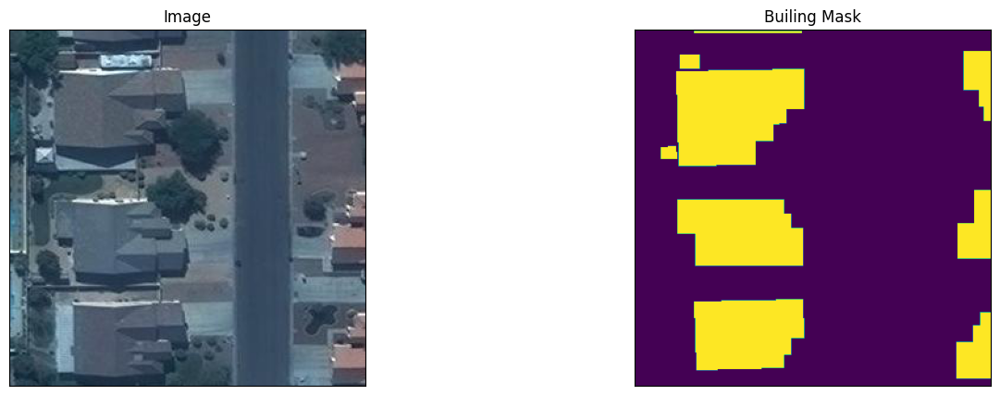

In [167]:
sample_dataset = SegDataset(root_dir=img_root_path,
                           img_ids=train_img_ids,
                           cat_ids=cat_ids,
                           coco_api=coco_anno)
image, mask = sample_dataset[4] # get some sample
visualize(
    image=image, 
    builing_mask=mask.squeeze(),
)

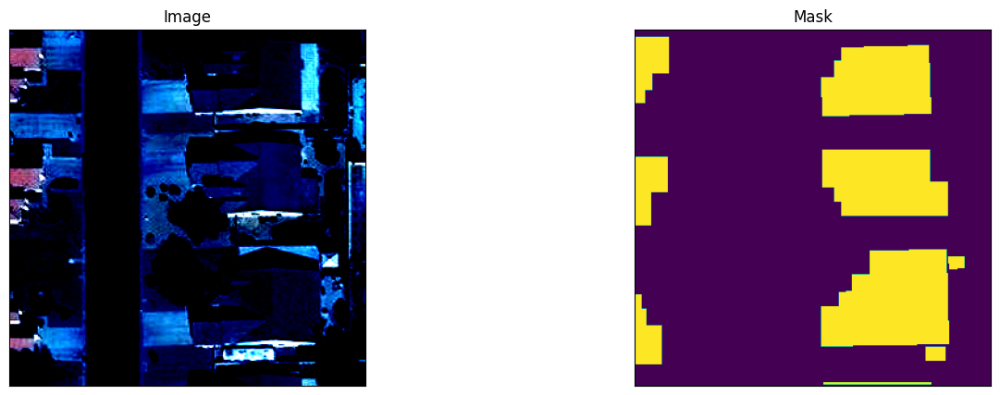

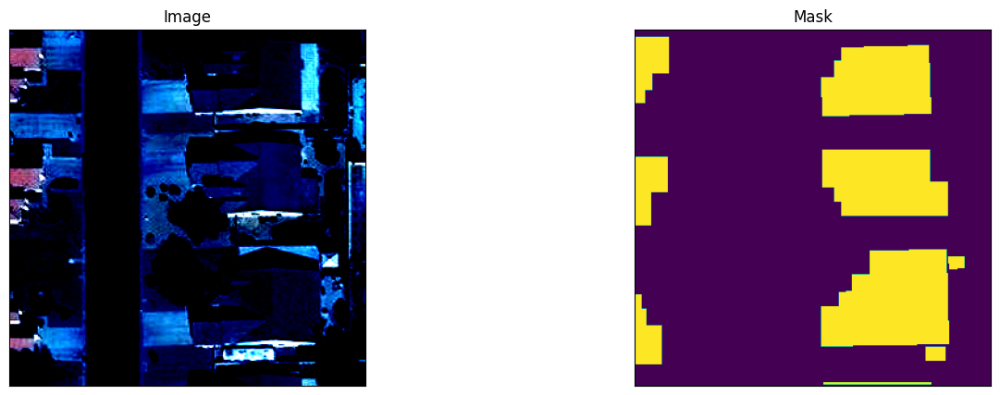

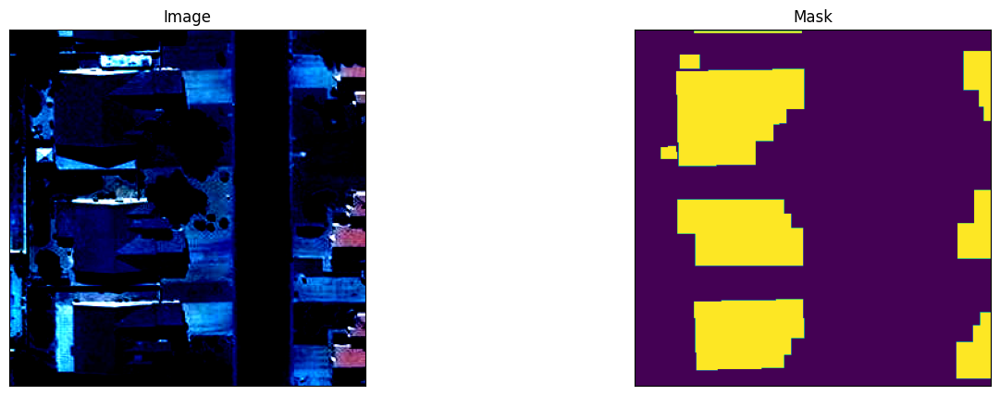

In [168]:
augmented_dataset = SegDataset(root_dir=img_root_path,
                               img_ids=train_img_ids,
                               cat_ids=cat_ids,
                               coco_api=coco_anno,
                               transforms=get_transform(resize=300, phase='train'))
for i in range(3):
    image, mask = augmented_dataset[4]
    visualize(image=image.numpy().transpose(1, 2, 0), mask=mask.squeeze())

In [169]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = ['building']
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multicalss segmentation

# create segmentation model with pretrained encoder
model = smp.Unet(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [170]:
_preprocessing = get_preprocessing(preprocessing_fn)

train_dataset = SegDataset(root_dir=img_root_path,
                           img_ids=train_img_ids,
                           cat_ids=cat_ids,
                           coco_api=coco_anno,
                           transforms=get_training_augmentation(288, 288),
                           preprocessing=_preprocessing)
valid_dataset = SegDataset(root_dir=img_root_path,
                           img_ids=valid_img_ids,
                           cat_ids=cat_ids,
                           coco_api=coco_anno,
                           transforms=get_validation_augmentation(288, 288),
                           preprocessing=_preprocessing)

/usr/local/lib/python3.10/dist-packages/albumentations/imgaug/transforms.py:263: FutureWarning: IAAAdditiveGaussianNoise is deprecated. Please use GaussNoise instead
  @property
/usr/local/lib/python3.10/dist-packages/albumentations/imgaug/transforms.py:386: FutureWarning: This IAAPerspective is deprecated. Please use Perspective instead
  @property
/usr/local/lib/python3.10/dist-packages/albumentations/augmentations/transforms.py:1613: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  Image types:
/usr/local/lib/python3.10/dist-packages/albumentations/imgaug/transforms.py:233: FutureWarning: IAASharpen is deprecated. Please use Sharpen instead
  @property
/usr/local/lib/python3.10/dist-packages/albumentations/augmentations/transforms.py:1639: FutureWarning: RandomContrast has been deprecated. Please use RandomBrightnessContrast
  warnings.warn(


In [171]:
train_loader = DataLoader(train_dataset,
                          batch_size=BATCH_SIZE,
                          shuffle=True,
                          num_workers=4,
                          pin_memory=True,
                          drop_last=True)
valid_loader = DataLoader(valid_dataset,
                          batch_size=BATCH_SIZE,
                          shuffle=False,
                          num_workers=4,
                          pin_memory=True,
                          drop_last=True)

In [190]:
!pip install utils

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [192]:
from segmentation_models_pytorch import utils

In [193]:
loss = smp.utils.losses.DiceLoss()
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]
optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.0001),
])

In [194]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=device,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=device,
    verbose=True,
)

In [195]:
max_score = 0


#train accurascy, train loss, val_accuracy, val_loss をグラフ化できるように設定．
x_epoch_data = []
train_dice_loss = []
train_iou_score = []
valid_dice_loss = []
valid_iou_score = []

for i in range(EPOCHS):

    print(f'\nEpoch: {i + 1}')
    train_logs = train_epoch.run(train_loader)
    valid_logs = valid_epoch.run(valid_loader)

    x_epoch_data.append(i)
    train_dice_loss.append(train_logs['dice_loss'])
    train_iou_score.append(train_logs['iou_score'])
    valid_dice_loss.append(valid_logs['dice_loss'])
    valid_iou_score.append(valid_logs['iou_score'])

    # do something (save model, change lr, etc.)
    if max_score < valid_logs['iou_score']:
        max_score = valid_logs['iou_score']
        torch.save(model, './best_model_Unet_resnet50.pth')
        print('Model saved!')

    if i == 25:
        optimizer.param_groups[0]['lr'] = 1e-5
        print('Decrease decoder learning rate to 1e-5!')


Epoch: 1
valid: 100%|██████████| 13/13 [00:02<00:00,  5.75it/s, dice_loss - 0.2871, iou_score - 0.6976]
Model saved!

Epoch: 2
valid: 100%|██████████| 13/13 [00:02<00:00,  5.80it/s, dice_loss - 0.2019, iou_score - 0.7478]
Model saved!

Epoch: 3
valid: 100%|██████████| 13/13 [00:02<00:00,  5.77it/s, dice_loss - 0.1656, iou_score - 0.7684]
Model saved!

Epoch: 4
valid: 100%|██████████| 13/13 [00:02<00:00,  5.76it/s, dice_loss - 0.1422, iou_score - 0.7801]
Model saved!

Epoch: 5
valid: 100%|██████████| 13/13 [00:02<00:00,  5.65it/s, dice_loss - 0.133, iou_score - 0.7842]
Model saved!

Epoch: 6
valid: 100%|██████████| 13/13 [00:02<00:00,  5.50it/s, dice_loss - 0.1294, iou_score - 0.7822]

Epoch: 7
valid: 100%|██████████| 13/13 [00:02<00:00,  5.72it/s, dice_loss - 0.1273, iou_score - 0.7821]

Epoch: 8
valid: 100%|██████████| 13/13 [00:02<00:00,  5.61it/s, dice_loss - 0.1207, iou_score - 0.7905]
Model saved!

Epoch: 9
valid: 100%|██████████| 13/13 [00:02<00:00,  5.75it/s, dice_loss - 0.1119

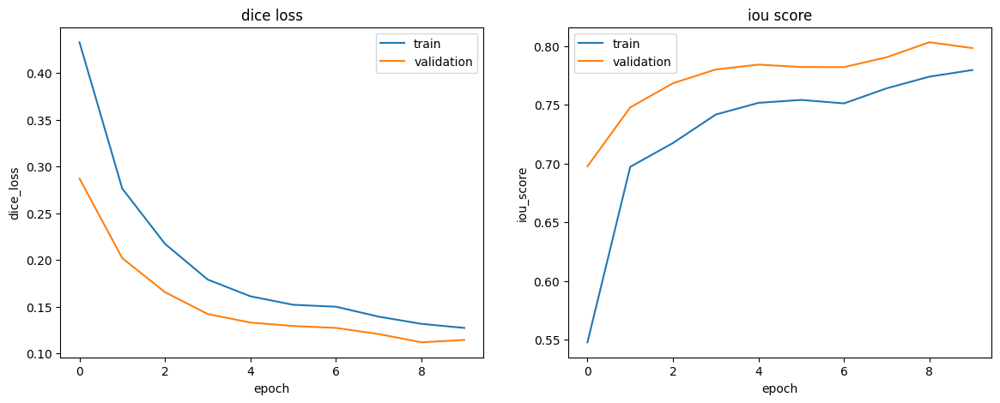

In [196]:
fig = plt.figure(figsize=(14, 5))

ax1 = fig.add_subplot(1, 2, 1)
line1, = ax1.plot(x_epoch_data,train_dice_loss,label='train') 
line2, = ax1.plot(x_epoch_data,valid_dice_loss,label='validation')
ax1.set_title("dice loss")
ax1.set_xlabel('epoch')
ax1.set_ylabel('dice_loss')
ax1.legend(loc='upper right')

ax2 = fig.add_subplot(1, 2, 2)
line1, = ax2.plot(x_epoch_data,train_iou_score,label='train')
line2, = ax2.plot(x_epoch_data,valid_iou_score,label='validation') 
ax2.set_title("iou score")
ax2.set_xlabel('epoch')
ax2.set_ylabel('iou_score')
ax2.legend(loc='upper left')

plt.show()

In [197]:
best_model = torch.load('./best_model_Unet_resnet50.pth')

In [198]:
test_dataset = SegDataset(root_dir=img_root_path,
                           img_ids=test_img_ids,
                           cat_ids=cat_ids,
                           coco_api=coco_anno,
                           transforms=get_validation_augmentation(288, 288),
                           preprocessing=_preprocessing)
test_dataloader = DataLoader(test_dataset)

In [199]:
test_epoch = smp.utils.train.ValidEpoch(
    model=best_model,
    loss=loss,
    metrics=metrics,
    device=device,
    verbose=True
)

logs = test_epoch.run(test_dataloader)

valid: 100%|██████████| 419/419 [00:09<00:00, 43.04it/s, dice_loss - 0.1443, iou_score - 0.7731]


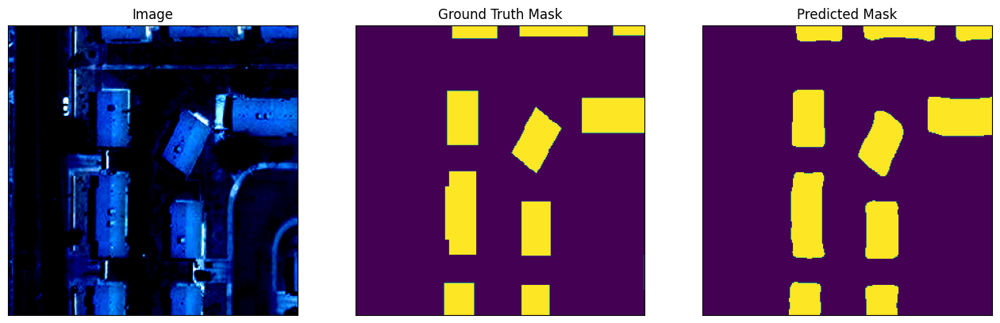

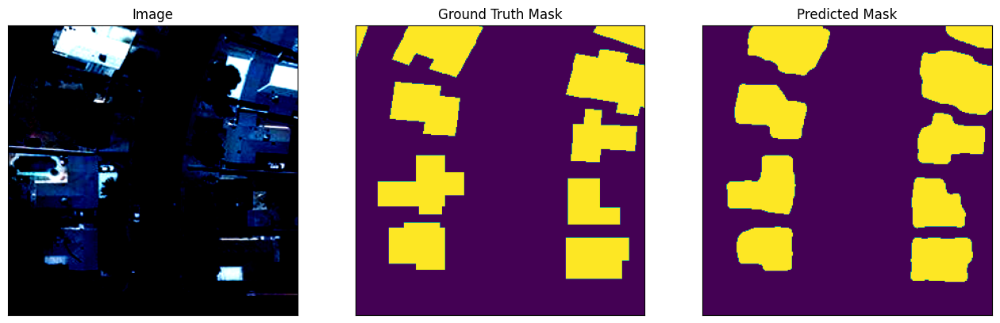

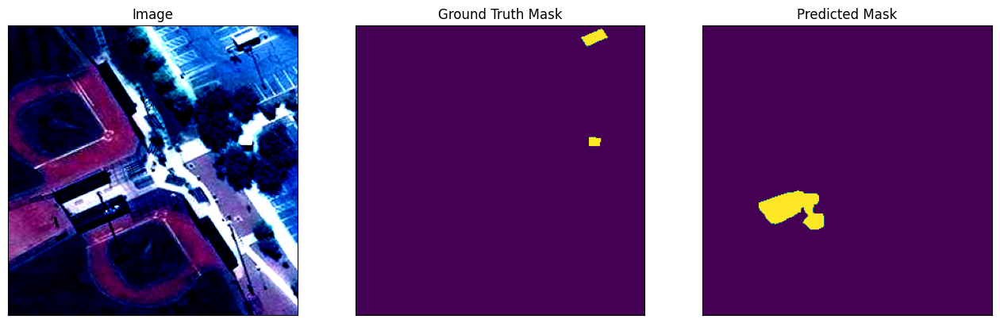

In [200]:
for i in range(3):
    n = np.random.choice(len(test_dataset))
    image, gt_mask = test_dataset[n]

    gt_mask = gt_mask.squeeze()

    x_tensor = torch.from_numpy(image).to(device).unsqueeze(0)
    pr_mask = best_model.predict(x_tensor)
    pr_mask = (pr_mask.squeeze().cpu().numpy().round())

    visualize(
        image=image.transpose(1, 2, 0), 
        ground_truth_mask=gt_mask, 
        predicted_mask=pr_mask
    )

In [215]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image
from pathlib import Path
from itertools import product
image_root_path = Path('/content/Foto')
model_path = Path('/content/train/Untitled8.ipynb')

In [216]:
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F

from torch.optim import Adam, SGD
from torch.nn.parameter import Parameter
from torch.utils.data import DataLoader, Dataset

from torchvision.io import read_image
import torchvision.models as models

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [217]:
import albumentations as albu
from albumentations import (
    Compose, OneOf, Normalize, Resize, RandomResizedCrop, RandomCrop, HorizontalFlip, VerticalFlip, 
    RandomBrightness, RandomContrast, RandomBrightnessContrast, Rotate, ShiftScaleRotate, Cutout, 
    IAAAdditiveGaussianNoise, Transpose, Lambda
    )
from albumentations.pytorch import ToTensorV2

In [218]:
import segmentation_models_pytorch as smp

In [219]:
print(torch.__version__)
print(albu.__version__)

2.0.1+cu118
1.2.1


In [220]:
def seed_torch(seed=42):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    

def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 5))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()
    
    
def split_images(image, image_path, out_path, grid_size=300):
    width, height = image.width, image.height
    w_max = int(width / grid_size)
    h_max = int(height / grid_size)
    for idx, (w_i, h_i) in enumerate(product(range(w_max), range(h_max))):
        w_x = w_i * grid_size
        h_y = h_i * grid_size
        
        crop_image = image.crop((w_x, h_y, w_x + grid_size, h_y + grid_size))
        image_file = f'{image_path.stem}_{idx}.jpg'
        new_image_path = out_path / image_file
        crop_image.save(new_image_path)
#     for w_i in range(w_max):
#         for h_i in range(h_max):
#             w_x = w_i * grid_size
#             h_y = h_i * grid_size


seed_torch()

In [225]:
model = torch.load('/content/best_model_Unet_resnet50.pth', map_location=device)

In [226]:
def get_validation_augmentation(width=320, height=320):
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
#         albu.PadIfNeeded(min_height=height, min_width=width)
        albu.Resize(width, height)
    ]
    return albu.Compose(test_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform

    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose

    """

    _transform = [
        Lambda(image=preprocessing_fn),
        Lambda(image=to_tensor, mask=to_tensor)
    ]
    return Compose(_transform)

In [227]:
# common processing dataset
class BaseDataset(Dataset):
    def __init__(self, img_files, transforms=None, preprocessing=None):
        self.img_files = img_files
        self.transform = transforms
        self.preprocessing = preprocessing
    
    def __len__(self):
        return len(self.img_files)
    
    def _read_image(self, idx):
        file_path = self.img_files[idx]
        image = Image.open(file_path).convert('RGB')
#         image = torchvision.io.read_image(file_path)
        return np.array(image)


class TestDataset(BaseDataset):
    def __getitem__(self, idx):
        image = self._read_image(idx)
        if self.transform:
            augmented = self.transform(image=image)
            image = augmented['image']
        
        if self.preprocessing:
            augmented = self.preprocessing(image=image)
            image = augmented['image']
            
        return image

In [228]:
!mkdir split_images

In [229]:
save_path = Path('split_images')

In [230]:
for img_path in image_root_path.glob('*.jpg'):
    image = Image.open(img_path)
    split_images(image, img_path, save_path, grid_size=300)

In [231]:
image_paths = list(save_path.glob('*.jpg'))

In [232]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)
_preprocessing = get_preprocessing(preprocessing_fn)

test_dataset = TestDataset(image_paths)

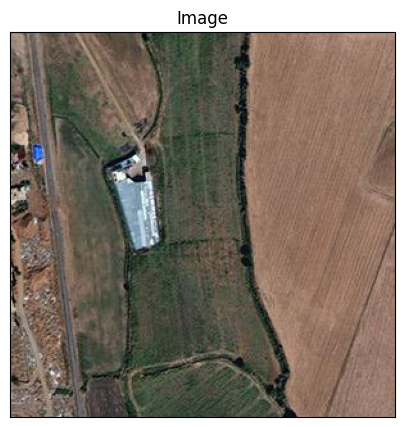

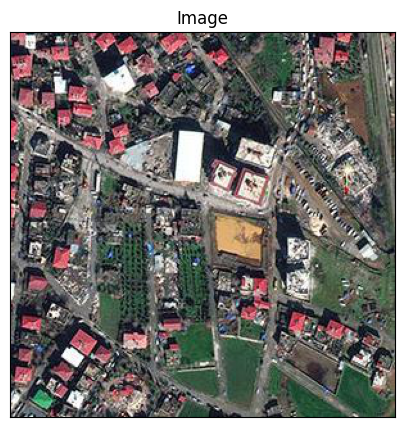

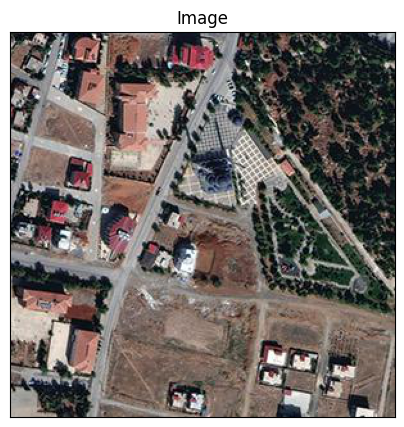

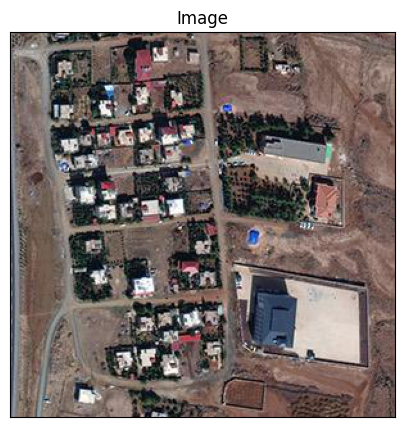

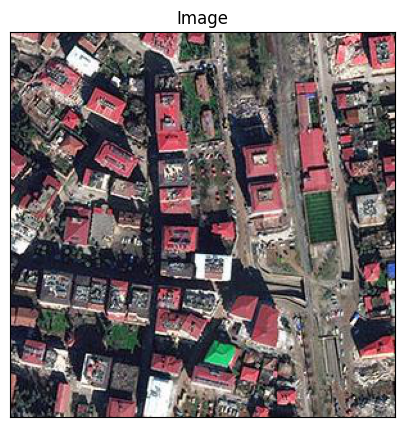

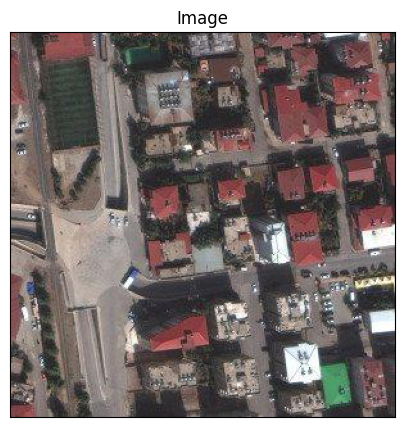

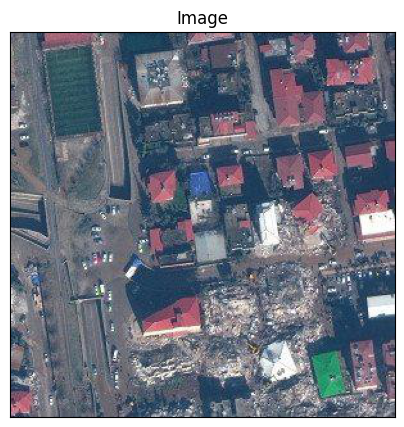

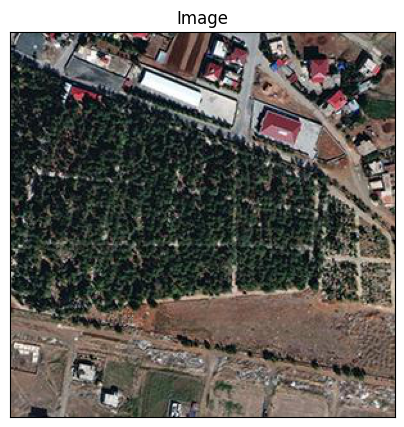

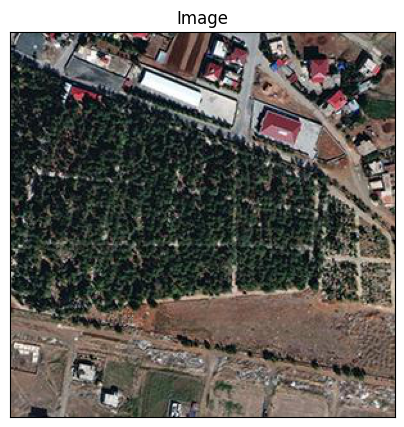

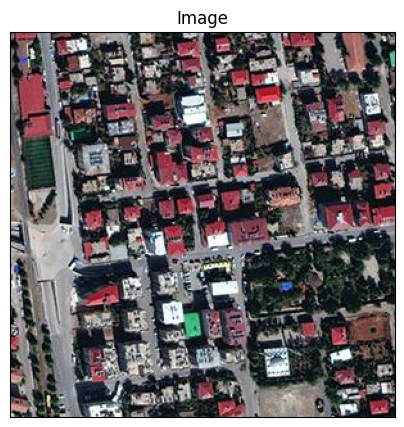

In [233]:
for i in range(10):
    n = np.random.choice(len(test_dataset))
    image = test_dataset[n]

    visualize(
        image=image
    )

In [234]:
def predict_mask(_model, _device, _image):
    x_tensor = torch.from_numpy(_image).to(_device).unsqueeze(0)
    pr_mask = _model.predict(x_tensor)
    pr_mask = (pr_mask.squeeze().cpu().numpy().round())
    return pr_mask

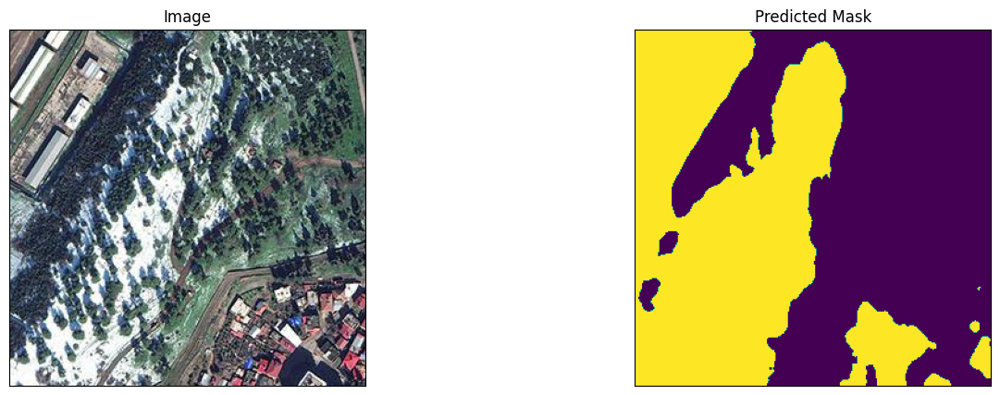

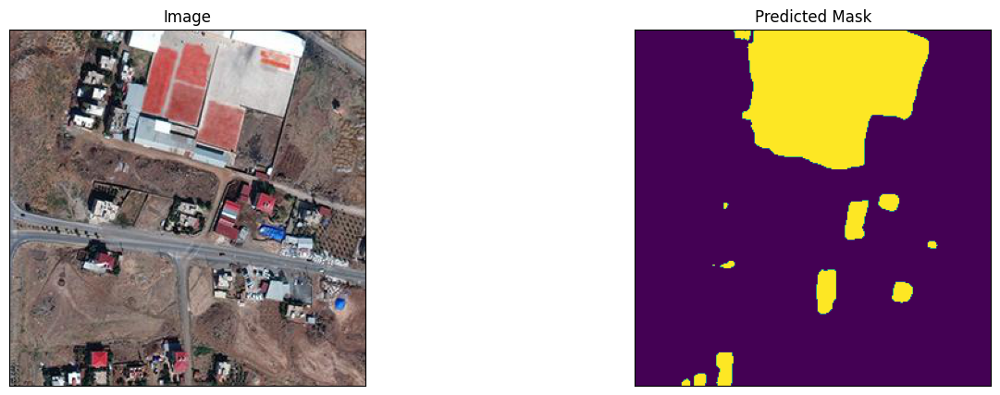

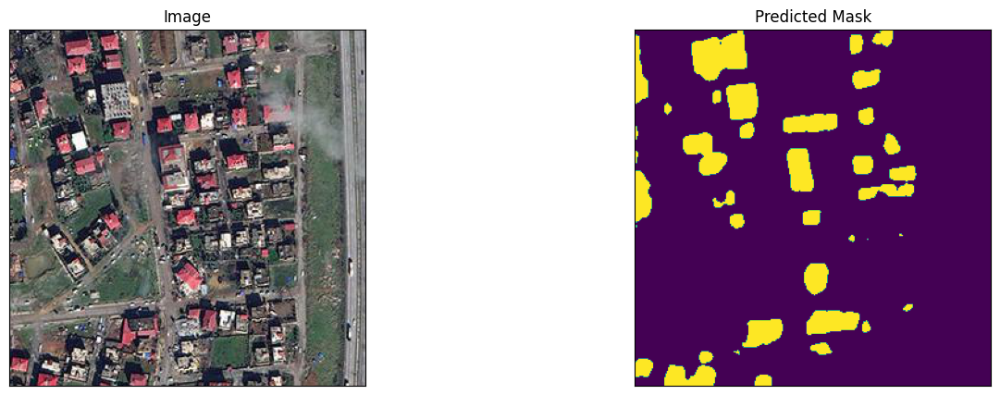

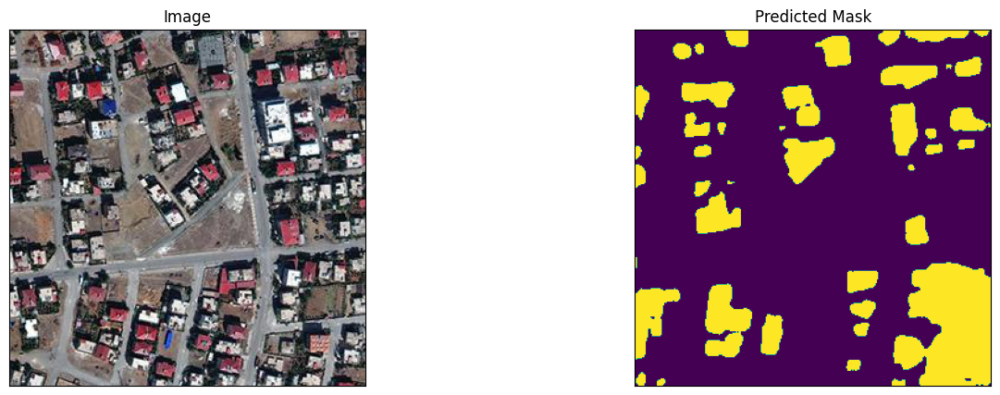

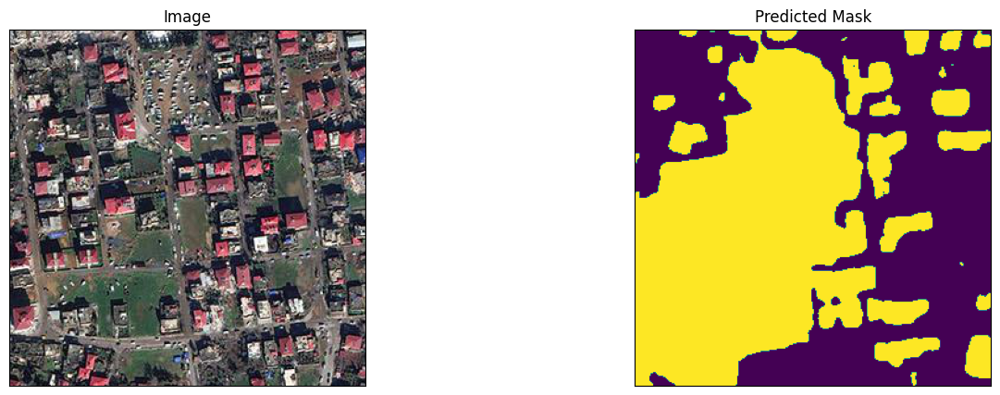

...

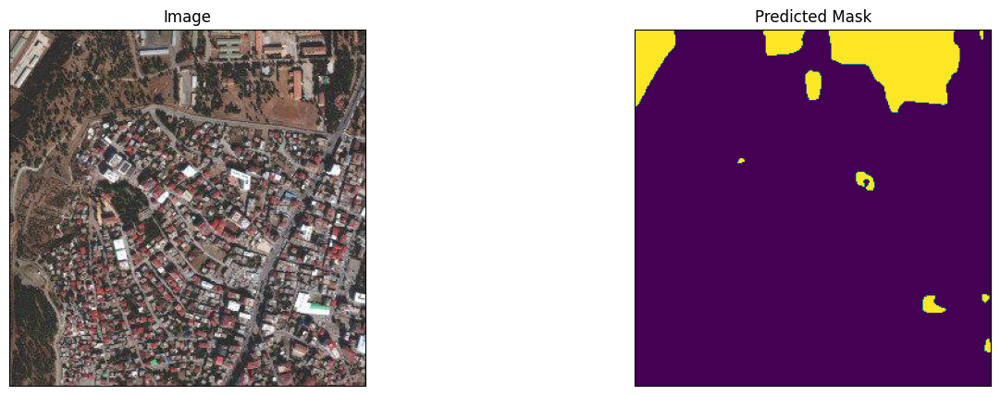

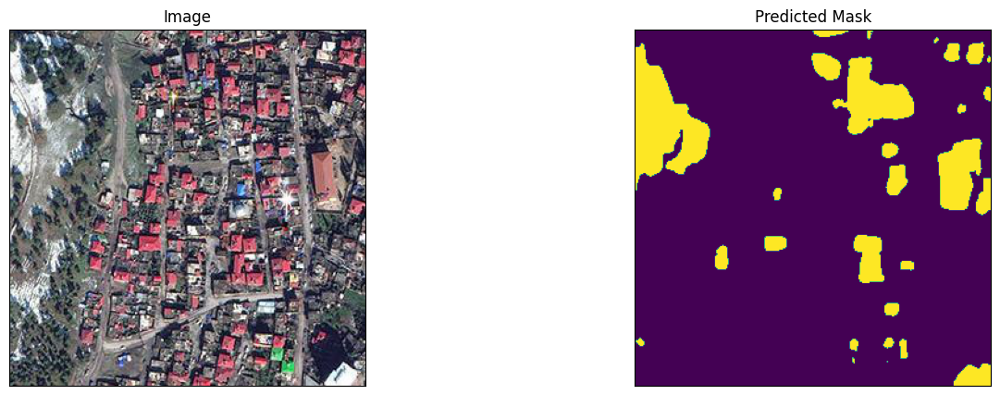

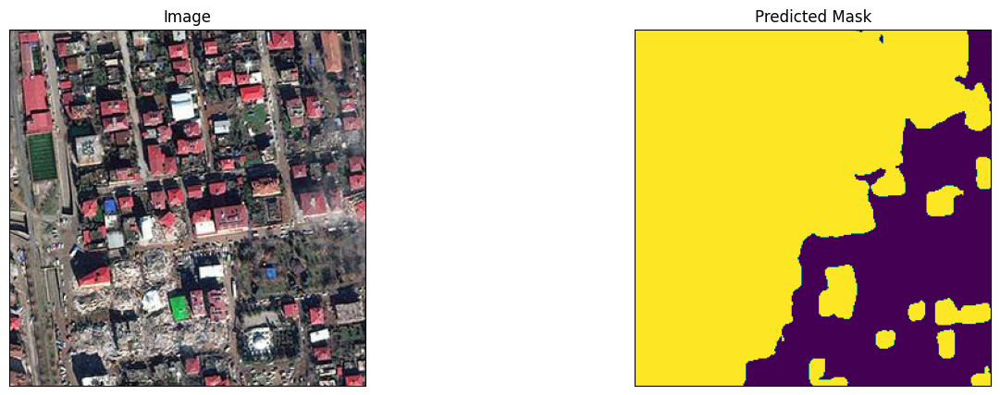

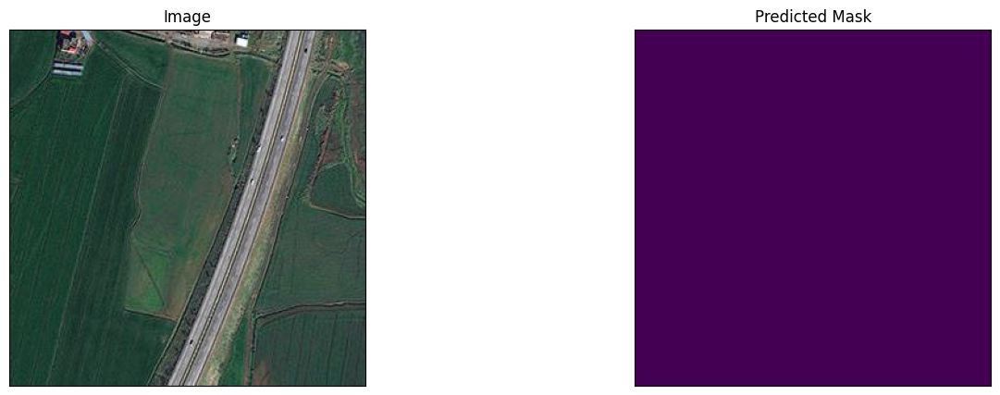

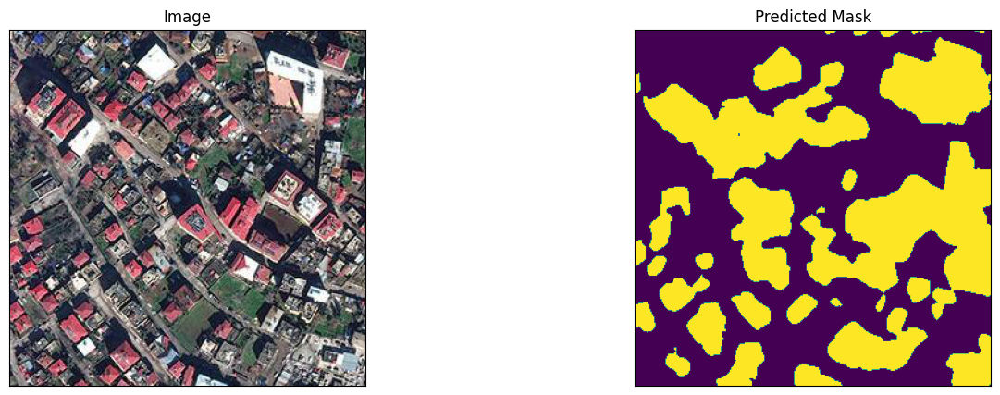

In [235]:
for i in range(50):
    image_path = image_paths[i]
    test_dataset = TestDataset([image_path],
                           transforms=get_validation_augmentation(288, 288),
                           preprocessing=_preprocessing)
    origin_image = np.array(Image.open(image_path).convert("RGB"))
    image = test_dataset[0]

    pr_mask = predict_mask(model, device, image)

    visualize(
        image=origin_image, 
        predicted_mask=pr_mask
    )